# AQI forecasting index

In this notebook, we want to forecast the Air Quality Index of station. The data comes from Kaggle and are hourly time series registered by stations in some Indian cities. 

Load libraries and data:

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
import os


from sklearn import preprocessing
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import r2_score, median_absolute_error, mean_absolute_error
from sklearn.metrics import median_absolute_error, mean_squared_error, mean_squared_log_error
from ydata_profiling import ProfileReport, compare

import missingno as msno
import warnings
warnings.filterwarnings('ignore')
import datetime
from datetime import datetime



#def mean_absolute_percentage_error(y_true, y_pred):
#    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100
# def mean_absolute_error(y_true,y_pred):
#    return np.mean(np.abs(y_true - y_pred))

%matplotlib inline
station_hour = pd.read_csv('/Users/piergiorgiopanero/Desktop/archive/station_hour.csv')
station_hour

,StationId,Datetime,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
0,AP001,2017-11-24 17:00:00,60.50,98.00,2.35,30.80,18.25,8.50,0.10,11.85,126.40,0.10,6.10,0.10,NaN,NaN
1,AP001,2017-11-24 18:00:00,65.50,111.25,2.70,24.20,15.07,9.77,0.10,13.17,117.12,0.10,6.25,0.15,NaN,NaN
2,AP001,2017-11-24 19:00:00,80.00,132.00,2.10,25.18,15.15,12.02,0.10,12.08,98.98,0.20,5.98,0.18,NaN,NaN
3,AP001,2017-11-24 20:00:00,81.50,133.25,1.95,16.25,10.23,11.58,0.10,10.47,112.20,0.20,6.72,0.10,NaN,NaN
4,AP001,2017-11-24 21:00:00,75.25,116.00,1.43,17.48,10.43,12.03,0.10,9.12,106.35,0.20,5.75,0.08,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2589078,WB013,2020-06-30 20:00:00,15.55,47.80,7.27,35.08,42.38,31.25,0.80,9.40,17.24,2.56,11.57,NaN,59.0,Satisfactory
2589079,WB013,2020-06-30 21:00:00,15.23,42.30,6.10,26.78,32.85,30.66,0.56,4.91,17.46,3.49,12.29,NaN,59.0,Satisfactory
2589080,WB013,2020-06-30 22:00:00,11.40,40.95,6.58,19.53,26.12,30.73,0.61,3.81,17.24,1.83,8.88,NaN,59.0,Satisfactory
2589081,WB013,2020-06-30 23:00:00,9.25,34.33,9.17,21.85,31.00,29.61,0.65,3.44,12.74,1.40,8.43,NaN,59.0,Satisfactory


In [2]:
station_hour.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2589083 entries, 0 to 2589082
Data columns (total 16 columns):
 #   Column      Dtype  
---  ------      -----  
 0   StationId   object 
 1   Datetime    object 
 2   PM2.5       float64
 3   PM10        float64
 4   NO          float64
 5   NO2         float64
 6   NOx         float64
 7   NH3         float64
 8   CO          float64
 9   SO2         float64
 10  O3          float64
 11  Benzene     float64
 12  Toluene     float64
 13  Xylene      float64
 14  AQI         float64
 15  AQI_Bucket  object 
dtypes: float64(13), object(3)
memory usage: 316.1+ MB


We can see immediately that Datetime is not in Datetime type, so we have to fix it in order to treat it as a time series.

In [3]:
def datetime_to_hours(dt, reference_dt):
    """
    Convert datetime to total elapsed hours
    :param dt: datetime object
    :param reference_dt: reference datetime object
    :return: total elapsed hours as an integer
    """
    time_diff = dt - reference_dt
    hours = time_diff.days * 24 + time_diff.seconds // 3600
    return hours

station_hour['Datetime'] = station_hour['Datetime'].apply(lambda x: datetime.strptime(x, "%Y-%m-%d %H:%M:%S"))

From heads and tails of station_hour we can notice some missing values. Let's plot the matrix of missing values to see how widespread is this issue.

<AxesSubplot:>

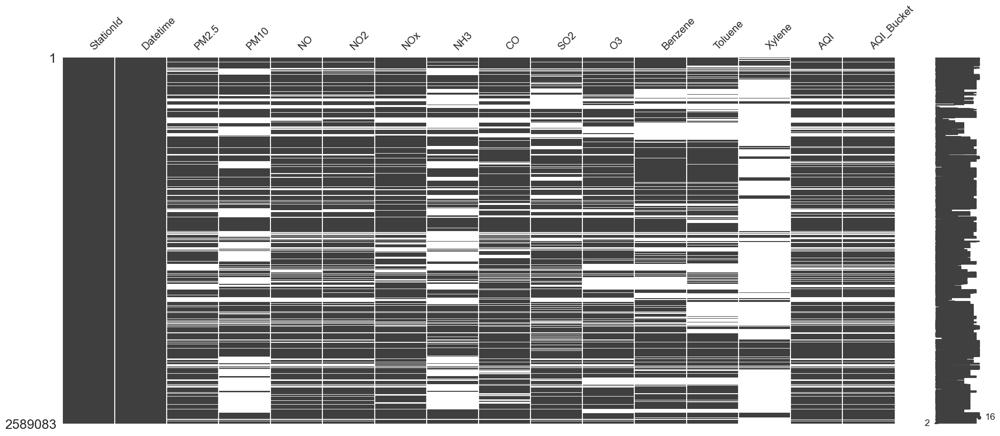

In [4]:
msno.matrix(station_hour)

From the missing values matrix, we can notice a huge number of missing values in Xylene, PM10 and NH3 mostly. But using ydata_profiling, we can get better informations with ProfileReport: 

There are lots of missing values, and many correlated variables. As benzene, toluene and xylene are higly correlated and are usually not considered in determining the AQI, we will drop these columns. Moreover, as the AQI bucket is nothing but a categorical variable depending by the AQI, we will drop this as well. 

In [6]:
station_hour.drop(['AQI_Bucket','Benzene','Toluene','Xylene'], axis=1, inplace=True)

Now we need to impute the missing values, and in order to do so, I will use the MICE (Multivariate Imputation by Chained Equations), a multivariate imputer that estimates each feature from all the others.

In [7]:
# Imputing with MICE
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn import linear_model

# Consider the subframe of numerical columns
filtered_station_hour = station_hour.filter(['PM2.5','PM10','NO','NO2','NOx','NH3','CO','SO2','O3','AQI'], axis=1).copy()

# Define MICE Imputer and fill missing values
# It's important to set the min_value = 0, in order to avoid meaningless values
mice_imputer = IterativeImputer(estimator=linear_model.BayesianRidge(), n_nearest_features=None, imputation_order='ascending',min_value=0)

# Impute MICE Imputer on filtered_station_hour
numerical_df = pd.DataFrame(mice_imputer.fit_transform(filtered_station_hour), columns=filtered_station_hour.columns)

# Concatenate numerical_df with the categorical columns
station_hour_mice = pd.concat([station_hour[['StationId', 'Datetime']], numerical_df], axis=1)

Now let's use ProfileReport again to compare the two reports. 
This way we will double check if we do not have any missing values anymore.

In [8]:
mice_report = ProfileReport(station_hour_mice)
comparison_report = report.compare(mice_report)
comparison_report.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [10]:
# Get the list of all different stations
station_list = station_hour['StationId'].unique().tolist()

# For each station, get out of station_hour the time series 
# associated to each station, with the right Datetime index, and dropping the StationId column
for name in station_list:
    globals()[f"{name}_df"] = station_hour_mice[station_hour_mice['StationId'] == name]
    globals()[f"{name}_df"] = globals()[f"{name}_df"].drop(['StationId'], axis=1, inplace=False)
    globals()[f"{name}_df"].set_index('Datetime', inplace=True)

# Create an empty dictionary to store the multivariate time series
# it will be used in global forecasting with Ridge regression
tseries_dict = {}

# Loop over each name in station_list
for name in station_list:
    
    # Store the filtered DataFrame in the dictionary
    tseries_dict[name] = globals()[f"{name}_df"]

Let's plot the AQI level from three different stations.

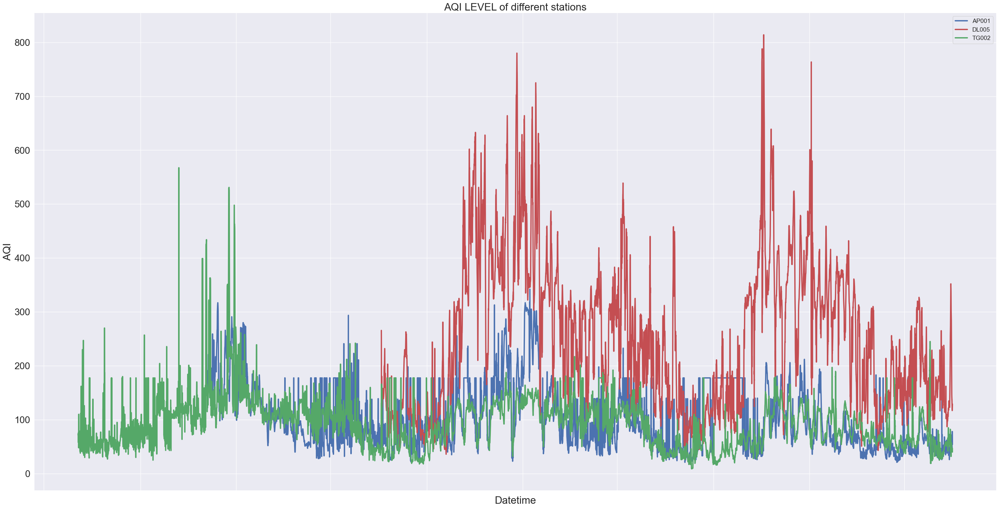

In [11]:
fig,ax = plt.subplots(figsize=(40, 20))

sns.despine(fig, left=True, bottom=True)
sns.set_context("notebook", font_scale=2, rc={"lines.linewidth": 3})

sns.lineplot(x="Datetime", y="AQI", data=AP001_df, color="b",label = 'AP001')
sns.lineplot(x="Datetime", y="AQI", data=DL005_df, color="r",label = 'DL005')
sns.lineplot(x="Datetime", y="AQI", data=TG002_df, color="g",label = 'TG002')


labels = [item.get_text() for item in ax.get_xticklabels()]
labels[1] = 'January 2015 to April 2020'
ax.set_xticklabels(ax.get_xticklabels(labels), rotation=30,ha="left")
plt.rcParams["xtick.labelsize"] = 15

ax.set_title('AQI LEVEL of different stations')
ax.legend(fontsize = 14)

Now let's build a function which creates new lagged columns:

In [12]:
import re

def time_delay_embedding(series: pd.Series,
                         n_lags: int,
                         horizon: int,
                         return_Xy: bool = False):
    """
    Time delay embedding
    Time series for supervised learning

    :param series: time series as pd.Series
    :param n_lags: number of past values to used as explanatory variables
    :param horizon: how many values to forecast
    :param return_Xy: whether to return the lags split from future observations

    :return: pd.DataFrame with reconstructed time series
    """
    assert isinstance(series, pd.Series)

    if series.name is None:
        name = 'Series'
    else:
        name = series.name

    n_lags_iter = list(range(n_lags, -horizon, -1))

    df_list = [series.shift(i) for i in n_lags_iter]
    df = pd.concat(df_list, axis=1).dropna()
    df.columns = [f'{name}(t-{j - 1})'
                  if j > 0 else f'{name}(t+{np.abs(j) + 1})'
                  for j in n_lags_iter]

    df.columns = [re.sub('t-0', 't', x) for x in df.columns]

    if not return_Xy:
        return df

    is_future = df.columns.str.contains('\+')

    X = df.iloc[:, ~is_future]
    Y = df.iloc[:, is_future]
    if Y.shape[1] == 1:
        Y = Y.iloc[:, 0]

    return X, Y

N_LAGS = 3
HORIZON = 1

# Define a sample matrix, mostly to define the predictor variables and target variables
mat_by_variable = []
for col in AP001_df:
    col_df = time_delay_embedding(AP001_df[col], n_lags=N_LAGS, horizon=HORIZON)
    mat_by_variable.append(col_df)

# concatenating all variables
mat_df = pd.concat(mat_by_variable, axis=1).dropna()

predictor_variables = mat_df.columns.str.contains('\(t\-|\(t\)')
target_variables = mat_df.columns.str.contains(r'AQI\(t\+1')


In [13]:
# Now we do the same for all the stations
for name in station_list:
    globals()[f"{name}_mat_by_variable"] = []
    for col in globals()[f"{name}_df"]:
        col_df = time_delay_embedding(globals()[f"{name}_df"][col], n_lags=N_LAGS, horizon=HORIZON)
        globals()[f"{name}_mat_by_variable"].append(col_df)
    globals()[f"{name}_mat_df"] = pd.concat(globals()[f"{name}_mat_by_variable"], axis=1).dropna()

Let's see what it gives: 

In [14]:
WB013_mat_df

,PM2.5(t-2),PM2.5(t-1),PM2.5(t),PM2.5(t+1),PM10(t-2),PM10(t-1),PM10(t),PM10(t+1),NO(t-2),NO(t-1),...,SO2(t),SO2(t+1),O3(t-2),O3(t-1),O3(t),O3(t+1),AQI(t-2),AQI(t-1),AQI(t),AQI(t+1)
Datetime,,,,,,,,,,,,,,,,,,,,,
2018-04-10 13:00:00,34.82,31.82,29.61,33.37,54.45,57.80,51.04,51.61,19.771080,11.045225,...,8.16,6.62,42.853972,40.914091,38.533875,38.540201,109.057887,106.795757,96.880748,97.122759
2018-04-10 14:00:00,31.82,29.61,33.37,36.71,57.80,51.04,51.61,58.00,11.045225,2.429057,...,6.62,6.80,40.914091,38.533875,38.540201,38.863732,106.795757,96.880748,97.122759,102.427607
2018-04-10 15:00:00,29.61,33.37,36.71,35.88,51.04,51.61,58.00,56.18,2.429057,3.931648,...,6.80,9.94,38.533875,38.540201,38.863732,38.323728,96.880748,97.122759,102.427607,91.999821
2018-04-10 16:00:00,33.37,36.71,35.88,37.16,51.61,58.00,56.18,53.08,3.931648,6.634943,...,9.94,19.37,38.540201,38.863732,38.323728,43.807250,97.122759,102.427607,91.999821,97.608307
2018-04-10 17:00:00,36.71,35.88,37.16,37.37,58.00,56.18,53.08,53.86,6.634943,4.126781,...,19.37,22.12,38.863732,38.323728,43.807250,45.483364,102.427607,91.999821,97.608307,96.440998
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-06-30 20:00:00,17.72,14.45,12.35,15.55,47.25,42.42,44.88,47.80,7.420000,9.320000,...,23.99,9.40,58.960000,27.570000,16.450000,17.240000,59.000000,59.000000,59.000000,59.000000
2020-06-30 21:00:00,14.45,12.35,15.55,15.23,42.42,44.88,47.80,42.30,9.320000,8.280000,...,9.40,4.91,27.570000,16.450000,17.240000,17.460000,59.000000,59.000000,59.000000,59.000000
2020-06-30 22:00:00,12.35,15.55,15.23,11.40,44.88,47.80,42.30,40.95,8.280000,7.270000,...,4.91,3.81,16.450000,17.240000,17.460000,17.240000,59.000000,59.000000,59.000000,59.000000


Great, now I defined a matrix out of any multivariate time series. I will now subdivide each of these matrices into a train and a test, before and after 2020-01-01 00:00:00.

In [15]:
training = {}
testing = {}

for name in station_list:
    globals()[f"{name}_train_df"] = globals()[f"{name}_mat_df"][:'2020-01-01 00:00:00']
    globals()[f"{name}_test_df"] = globals()[f"{name}_mat_df"]['2020-01-01 00:00:00':]
    training[name] = globals()[f"{name}_train_df"].dropna().reset_index(drop=True)
    testing[name] = globals()[f"{name}_test_df"].dropna().reset_index(drop=True)

# Concatenate the dictionaries in order to get data frames
train_df = pd.concat(training, axis=0)
test_df = pd.concat(testing, axis=0)

In [16]:
train_df

PM2.5(t-2)  PM2.5(t-1)  PM2.5(t)  PM2.5(t+1)  PM10(t-2)  \
AP001 0           60.50       65.50     80.00       81.50      98.00   
      1           65.50       80.00     81.50       75.25     111.25   
      2           80.00       81.50     75.25       69.25     132.00   
      3           81.50       75.25     69.25       67.50     133.25   
      4           75.25       69.25     67.50       68.00     116.00   
...                 ...         ...       ...         ...        ...   
WB013 15127       68.65       67.15     73.68       89.47     137.95   
      15128       67.15       73.68     89.47      118.50     140.28   
      15129       73.68       89.47    118.50      148.10     158.80   
      15130       89.47      118.50    148.10      176.72     190.12   
      15131      118.50      148.10    176.72      186.70     240.52   

             PM10(t-1)  PM10(t)  PM10(t+1)    NO(t-2)     NO(t-1)  ...  \
AP001 0         111.25   132.00     133.25    2.35000    2.700000  ...   
      1         132.00   133.25     116.00    2.70000    2.100000  ...   
      2         133.25   116.00     108.25    2.10000    1.950000  ...   
      3         116.00   108.25     111.50    1.95000    1.430000  ...   
      4         108.25   111.50     111.00    1.43000    0.700000  ...   
...                ...      ...        ...        ...         ...  ...   
WB013 15127     140.28   158.80     190.12    2.82000   44.620000  ...   
      15128     158.80   190.12     240.52   44.62000  135.970000  ...   
      15129     190.12   240.52     294.65  135.97000  383.750000  ...   
      15130     240.52   294.65     355.38  383.75000   52.891910  ...   
      15131     294.65   355.38     379.10   52.89191   54.838983  ...   

             SO2(t)  SO2(t+1)  O3(t-2)  O3(t-1)   O3(t)  O3(t+1)    AQI(t-2)  \
AP001 0       12.08     10.47   126.40   117.12   98.98   112.20  154.784978   
      1       10.47      9.12   117.12    98.98  112.20   106.35  159.927760   
      2        9.12      9.25    98.98   112.20  106.35    91.10  168.194927   
      3        9.25      9.40   112.20   106.35   91.10   112.70  172.023558   
      4        9.40      8.90   106.35    91.10  112.70   116.12  158.332196   
...             ...       ...      ...      ...     ...      ...         ...   
WB013 15127   10.76     11.41    42.82     4.92    3.21     3.69  311.000000   
      15128   11.41     11.46     4.92     3.21    3.69     3.62  311.000000   
      15129   11.46     10.29     3.21     3.69    3.62     3.20  310.000000   
      15130   10.29      8.60     3.69     3.62    3.20     2.91  310.000000   
      15131    8.60      7.97     3.62     3.20    2.91     2.75  309.000000   

               AQI(t-1)      AQI(t)    AQI(t+1)  
AP001 0      159.927760  168.194927  172.023558  
      1      168.194927  172.023558  158.332196  
      2      172.023558  158.332196  148.346797  
      3      158.332196  148.346797  160.438854  
      4      148.346797  160.438854  163.381310  
...                 ...         ...         ...  
WB013 15127  311.000000  310.000000  310.000000  
      15128  310.000000  310.000000  309.000000  
      15129  310.000000  309.000000  309.000000  
      15130  309.000000  309.000000  309.000000  
      15131  309.000000  309.000000  308.000000  

[2126789 rows x 40 columns]

In [19]:
test_df

PM2.5(t-2)  PM2.5(t-1)   PM2.5(t)  PM2.5(t+1)  PM10(t-2)  \
AP001 0      48.250000   51.500000  59.000000   37.951767  75.250000   
      1      51.500000   59.000000  37.951767   38.418737  79.750000   
      2      59.000000   37.951767  38.418737   68.000000  91.000000   
      3      37.951767   38.418737  68.000000   68.000000  87.262733   
      4      38.418737   68.000000  68.000000   68.500000  88.090721   
...                ...         ...        ...         ...        ...   
WB013 4364   17.720000   14.450000  12.350000   15.550000  47.250000   
      4365   14.450000   12.350000  15.550000   15.230000  42.420000   
      4366   12.350000   15.550000  15.230000   11.400000  44.880000   
      4367   15.550000   15.230000  11.400000    9.250000  47.800000   
      4368   15.230000   11.400000   9.250000   10.500000  42.300000   

            PM10(t-1)    PM10(t)  PM10(t+1)    NO(t-2)    NO(t-1)  ...  \
AP001 0     79.750000  91.000000  87.262733   1.320000   0.820000  ...   
      1     91.000000  87.262733  88.090721   0.820000   1.700000  ...   
      2     87.262733  88.090721  99.000000   1.700000  12.075651  ...   
      3     88.090721  99.000000  98.500000  12.075651  12.152529  ...   
      4     99.000000  98.500000  96.000000  12.152529   1.100000  ...   
...               ...        ...        ...        ...        ...  ...   
WB013 4364  42.420000  44.880000  47.800000   7.420000   9.320000  ...   
      4365  44.880000  47.800000  42.300000   9.320000   8.280000  ...   
      4366  47.800000  42.300000  40.950000   8.280000   7.270000  ...   
      4367  42.300000  40.950000  34.330000   7.270000   6.100000  ...   
      4368  40.950000  34.330000  36.500000   6.100000   6.580000  ...   

               SO2(t)   SO2(t+1)    O3(t-2)    O3(t-1)      O3(t)    O3(t+1)  \
AP001 0      8.850469   9.027474  66.200000  59.420000  55.650000  33.210484   
      1      9.027474   9.054337  59.420000  55.650000  33.210484  33.273077   
      2      9.054337   7.000000  55.650000  33.210484  33.273077  61.900000   
      3      7.000000  12.200000  33.210484  33.273077  61.900000  56.150000   
      4     12.200000  14.900000  33.273077  61.900000  56.150000  52.900000   
...               ...        ...        ...        ...        ...        ...   
WB013 4364  23.990000   9.400000  58.960000  27.570000  16.450000  17.240000   
      4365   9.400000   4.910000  27.570000  16.450000  17.240000  17.460000   
      4366   4.910000   3.810000  16.450000  17.240000  17.460000  17.240000   
      4367   3.810000   3.440000  17.240000  17.460000  17.240000  12.740000   
      4368   3.440000   2.800000  17.460000  17.240000  12.740000  13.100000   

            AQI(t-2)  AQI(t-1)  AQI(t)  AQI(t+1)  
AP001 0         88.0      88.0    84.0      83.0  
      1         88.0      84.0    83.0      84.0  
      2         84.0      83.0    84.0      86.0  
      3         83.0      84.0    86.0      88.0  
      4         84.0      86.0    88.0      89.0  
...              ...       ...     ...       ...  
WB013 4364      59.0      59.0    59.0      59.0  
      4365      59.0      59.0    59.0      59.0  
      4366      59.0      59.0    59.0      59.0  
      4367      59.0      59.0    59.0      59.0  
      4368      59.0      59.0    59.0      59.0  

[462066 rows x 40 columns]

In [17]:
# Select only the columns we are intereted in
X_train = train_df.iloc[:, predictor_variables]
y_train = train_df.iloc[:, target_variables]
X_test = test_df.iloc[:, predictor_variables]
y_test = test_df.iloc[:, target_variables]

In [18]:
X_train

PM2.5(t-2)  PM2.5(t-1)  PM2.5(t)  PM10(t-2)  PM10(t-1)  PM10(t)  \
AP001 0           60.50       65.50     80.00      98.00     111.25   132.00   
      1           65.50       80.00     81.50     111.25     132.00   133.25   
      2           80.00       81.50     75.25     132.00     133.25   116.00   
      3           81.50       75.25     69.25     133.25     116.00   108.25   
      4           75.25       69.25     67.50     116.00     108.25   111.50   
...                 ...         ...       ...        ...        ...      ...   
WB013 15127       68.65       67.15     73.68     137.95     140.28   158.80   
      15128       67.15       73.68     89.47     140.28     158.80   190.12   
      15129       73.68       89.47    118.50     158.80     190.12   240.52   
      15130       89.47      118.50    148.10     190.12     240.52   294.65   
      15131      118.50      148.10    176.72     240.52     294.65   355.38   

               NO(t-2)     NO(t-1)       NO(t)  NO2(t-2)  ...  CO(t)  \
AP001 0        2.35000    2.700000    2.100000     30.80  ...   0.10   
      1        2.70000    2.100000    1.950000     24.20  ...   0.10   
      2        2.10000    1.950000    1.430000     25.18  ...   0.10   
      3        1.95000    1.430000    0.700000     16.25  ...   0.10   
      4        1.43000    0.700000    1.050000     17.48  ...   0.10   
...                ...         ...         ...       ...  ...    ...   
WB013 15127    2.82000   44.620000  135.970000     58.65  ...   1.34   
      15128   44.62000  135.970000  383.750000     96.05  ...   1.29   
      15129  135.97000  383.750000   52.891910    101.22  ...   1.69   
      15130  383.75000   52.891910   54.838983     93.18  ...   1.98   
      15131   52.89191   54.838983  462.500000     79.67  ...   3.33   

             SO2(t-2)  SO2(t-1)  SO2(t)  O3(t-2)  O3(t-1)   O3(t)    AQI(t-2)  \
AP001 0         11.85     13.17   12.08   126.40   117.12   98.98  154.784978   
      1         13.17     12.08   10.47   117.12    98.98  112.20  159.927760   
      2         12.08     10.47    9.12    98.98   112.20  106.35  168.194927   
      3         10.47      9.12    9.25   112.20   106.35   91.10  172.023558   
      4          9.12      9.25    9.40   106.35    91.10  112.70  158.332196   
...               ...       ...     ...      ...      ...     ...         ...   
WB013 15127     12.06      9.38   10.76    42.82     4.92    3.21  311.000000   
      15128      9.38     10.76   11.41     4.92     3.21    3.69  311.000000   
      15129     10.76     11.41   11.46     3.21     3.69    3.62  310.000000   
      15130     11.41     11.46   10.29     3.69     3.62    3.20  310.000000   
      15131     11.46     10.29    8.60     3.62     3.20    2.91  309.000000   

               AQI(t-1)      AQI(t)  
AP001 0      159.927760  168.194927  
      1      168.194927  172.023558  
      2      172.023558  158.332196  
      3      158.332196  148.346797  
      4      148.346797  160.438854  
...                 ...         ...  
WB013 15127  311.000000  310.000000  
      15128  310.000000  310.000000  
      15129  310.000000  309.000000  
      15130  309.000000  309.000000  
      15131  309.000000  309.000000  

[2126789 rows x 30 columns]

In [21]:
# Import Ridge regression from Sklearn linear model
from sklearn.linear_model import Ridge


global_model = Ridge()
# Fit the model on our training data
global_model.fit(X_train, y_train)

Ridge()

In [23]:
# Predict the test with our trained model
y_pred_ridge = global_model.predict(X_test)

# print the mean absolute error
print('Mean Absolute Error (MAE): ', mean_absolute_error(y_test,y_pred_ridge))
def mean_absolute_percentage_error(y_true, y_pred):
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100
print('Mean Absolute Percentage Error (MAPE): ', mean_absolute_percentage_error(y_test,y_pred_ridge))

Mean Absolute Error (MAE):  5.202317631431961
Mean Absolute Percentage Error (MAPE):  AQI(t+1)    4.768915
dtype: float64
